# Barkour v0 Joystick

<a href="https://colab.research.google.com/github/google/brax/blob/main/brax/experimental/barkour_v0/barkour_v0_joystick.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" width="140" align="center"/></a> This notebook demonstrates training a joystick policy for the Barkour v0 environment with domain randomization.

### Copyright notice

> <p><small><small>Copyright 2023 DeepMind Technologies Limited.</small></p>
> <p><small><small>Licensed under the Apache License, Version 2.0 (the "License"); you may not use this file except in compliance with the License. You may obtain a copy of the License at <a href="http://www.apache.org/licenses/LICENSE-2.0">http://www.apache.org/licenses/LICENSE-2.0</a>.</small></small></p>
> <p><small><small>Unless required by applicable law or agreed to in writing, software distributed under the License is distributed on an "AS IS" BASIS, WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied. See the License for the specific language governing permissions and limitations under the License.</small></small></p>

### Imports

In [ ]:
#@markdown ## ⚠️ PLEASE NOTE:
#@markdown This colab runs best using a TPU Cloud VM runtime.
#@markdown * From the Colab menu, choose "Connect to a custom GCE VM".
#@markdown
#@markdown A GPU runtime can be selected from Runtime > Change Runtime Type, but GPU training performance is not well tuned, and is left for a future release.

from datetime import datetime
import functools
import os
from IPython.display import HTML, clear_output

try:
  import brax
except ImportError:
  !pip install git+https://github.com/google/brax.git@main
  clear_output()
  import brax

import flax
from brax import envs
from brax.experimental.barkour_v0 import barkour_joystick
from brax.io import model
from brax.io import json
from brax.io import html
from brax.training.agents.ppo import train as ppo
from brax.training.agents.ppo import networks as ppo_networks
import jax
import jax.numpy as jp
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 16})

In [ ]:
jax.devices()

# Environment

First let's create the environment and visualize it.


In [ ]:
barkour_env = envs.create('barkour_v0_joystick',
    backend='generalized', kick_vel=0.05
)
state = jax.jit(barkour_env.reset)(rng=jax.random.PRNGKey(seed=0))

HTML(html.render(barkour_env.sys, [state.pipeline_state]))

# Train

The joystick policy takes in commands of the form `[x, y, w]`, where `[x, y]` are the linear velocity relative to the robot, and `[w]` is an angular velocity about the z-axis. The `Barkourv0` environment contains velocity tracking rewards to make sure the quadruped follows these joystick commands. Other rewards ensure the robot orientation and walking gait are smooth (e.g. the `action_rate` behaves like a low-pass filter on the actuation rate).

We train the policy with domain randomization by using the `domain_randomize` function from [`barkour_joystick.py`](https://github.com/google/brax/blob/main/brax/experimental/barkour_v0/barkour_joystick.py). This randomizes the actuator gains, center of mass of the torso, and friction, which helps with sim2real transfer.

The training script below optimizes and plots the joystick reward, but also prints out the total distance that the quadruped travels relative the origin as a proxy metric.

Total dist:  2.4292915


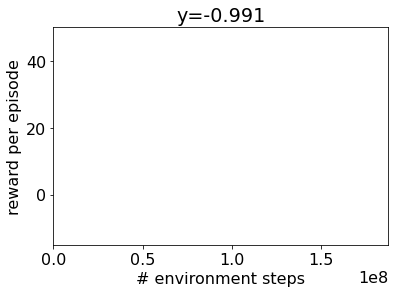

Total dist:  127.773895


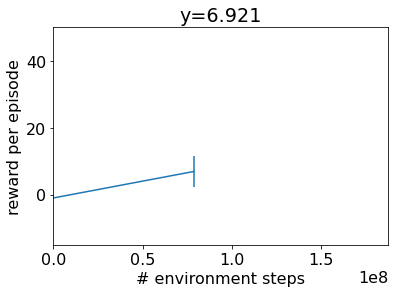

Total dist:  667.2552


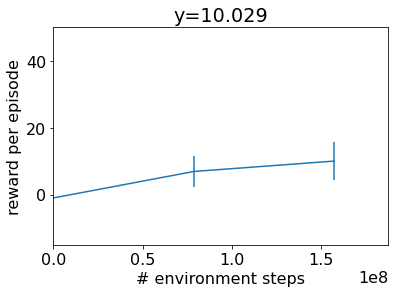

time to jit: 0:00:39.318410
time to train: 0:10:32.681755


In [ ]:
make_networks_factory = functools.partial(
    ppo_networks.make_ppo_networks,
        policy_hidden_layer_sizes=(128,) * 4)
train_fn = functools.partial(
      ppo.train, num_timesteps=150_000_000, num_evals=3,
      reward_scaling=1, episode_length=1000, normalize_observations=True,
      action_repeat=1, unroll_length=20, num_minibatches=32,
      gae_lambda=0.95,
      num_updates_per_batch=4, discounting=0.99, learning_rate=3.0e-4,
      entropy_cost=1e-2, num_envs=8192, batch_size=1024, seed=1,
      network_factory=make_networks_factory,
      randomization_fn=barkour_joystick.domain_randomize,
      num_resets_per_eval=10)

max_y = 50
min_y = -15

xdata = []
ydata = []
ydataerr = []
times = [datetime.now()]

def progress(num_steps, metrics):
  times.append(datetime.now())
  xdata.append(num_steps)
  ydata.append(metrics['eval/episode_reward'])
  ydataerr.append(metrics['eval/episode_reward_std'])

  print('Total dist: ', metrics['eval/episode_total_dist'])

  plt.xlim([0, train_fn.keywords['num_timesteps'] * 1.25])
  plt.ylim([min_y, max_y])
  plt.xlabel('# environment steps')
  plt.ylabel('reward per episode')
  plt.title(f'y={ydata[-1]:.3f}')

  plt.errorbar(
      xdata, ydata, yerr=ydataerr)
  plt.show()

# Reset environments since internals may be overwritten by tracers.
barkour_env = envs.create('barkour_v0_joystick',
    backend='generalized', kick_vel=0.05
)
eval_env = envs.create('barkour_v0_joystick',
    backend='generalized', kick_vel=0.05)
make_inference_fn, params, _= train_fn(environment=barkour_env,
                                       progress_fn=progress,
                                       eval_env=eval_env)

print(f'time to jit: {times[1] - times[0]}')
print(f'time to train: {times[-1] - times[1]}')

In [ ]:
#@title save model
model_path = '/tmp/barkour_joystick'
model.save_params(model_path, params)

In [ ]:
#@title load model
params = model.load_params(model_path)

inference_fn = make_inference_fn(params)
jit_inference_fn = jax.jit(inference_fn)

In [ ]:
barkour_env = envs.create('barkour_v0_joystick',
    backend='generalized', kick_vel=0.05, auto_reset=False,
)
jit_env_reset = jax.jit(barkour_env.reset)
jit_env_step = jax.jit(barkour_env.step)

# Eval

Try out different joystick commands by changing the values below!

In [ ]:
x_vel = 0.8  #@param {type: "number"}
y_vel = 0.0  #@param {type: "number"}
ang_vel = 0.2  #@param {type: "number"}

the_command = jp.array([x_vel, y_vel, ang_vel])

rollout = []
rng = jax.random.PRNGKey(seed=0)
state = jit_env_reset(rng=rng)

rewards, reward = [], []

for i in range(500):
  rollout.append(state.pipeline_state)
  act_rng, rng = jax.random.split(rng)

  state.info['command'] = the_command
  act, _ = jit_inference_fn(state.obs, act_rng)
  rewards.append(state.info['rew_tuple'])
  reward.append(state.reward)
  state = jit_env_step(state, act)
  if state.done:
    print('done at t=', i)
    break

HTML(html.render(barkour_env.sys.replace(dt=barkour_env.dt), rollout))

We can plot the overall reward function below along with all the reward components below.

In [ ]:
plt.plot(reward)
plt.title(f'reward={sum(reward):.3f}')

In [ ]:
for k, v in state.info['rew_tuple'].items():
  plt.plot([r[k] for r in rewards])
  plt.title(k)
  plt.show()